# Generative Adversarial Network to colorize portraits
After we finished with UNET we tried out some GAN models too.
The architecture of the generator is the same UNET we used alone before, just added the input layer to the output layers at the end. This is needed because we need all three channels for the discriminator. Because of this concept we made an discriminator network alone. So we can initialize our GAN model with the weights of last UNET and the weights of discriminator.
But this initialization didn't make any significant effect on the final results compared to the model which was initialized random.

In [1]:
from keras.layers import Input, Reshape, Dropout, BatchNormalization, Conv2D, UpSampling2D, MaxPooling2D, concatenate
from keras.layers.core import Activation, Dense, Flatten
from keras.layers.advanced_activations import LeakyReLU
from keras.models import Sequential, Model
from keras.optimizers import Adam
from keras.models import load_model, save_model
from matplotlib.colors import LinearSegmentedColormap
from skimage.color import rgb2lab, lab2rgb
import matplotlib.pyplot as plt
import numpy as np
import h5py
from keras.utils.generic_utils import get_custom_objects
import tensorflow as tf
import csv, os
from PIL import Image as PImage
from IPython.display import clear_output

C:\ProgramData\Anaconda3\lib\site-packages\h5py\__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
# yields a batch for neural neetwork
# X_batch: L channel of images - from where our network will predict color channels
# lab_batch: all 3 lab channels of images - the real (desired) values
def generatorGan(h5dataset, batch_size = 32, seed = 1):
    indices = list(range(h5dataset.shape[0])) # array of the indices
    while True: # infinite generator
        np.random.seed(seed) # set seed so shuffle will be repeatable
        np.random.shuffle(indices) # shuffle before every epoch
        for i in range(0, len(indices) - batch_size + 1, batch_size):
            batch_indices = sorted(indices[i:i+batch_size]) # only sorted list can index more elements at once
            lab_batch = h5dataset[batch_indices].astype(np.float32) # get Lab pictures from dataset
            lab_batch[:,:,:,0:1] = lab_batch[:,:,:,0:1]/100 # scale L layer
            lab_batch[:,:,:,1:3] = (lab_batch[:,:,:,1:3] +128) / 255 # scale A and B layers
            X_batch = lab_batch[:,:,:,0:1] # L channel is our input
            yield (X_batch,lab_batch)
            
# plots the original pictures, the predicted ones by model, and the inputs
def plot_results(model, picture):
    if np.max(picture) > 1.01: # if the picture is not normalized we normalize it here
        picture = picture.astype(np.float32)
        picture[:,:,:,0:1] = picture[:,:,:,0:1]/100 # L channel
        picture[:,:,:,1:3] = (picture[:,:,:,1:3] + 128)/255 # A and B channels
        
    preds = model.predict(picture[:,:,:,0:1]) # predicting picture
    plt.rcParams["figure.figsize"] = [15,10] # bigger plot size
    
    for ind in range(picture.shape[0]): # iterating over all pictures
        
        # plot original
        plt.subplot(131) # 1 row, 3 column, 1st picture
        plt.title('Original')
        plt.grid(False) # no grid
        plt.axis('off') # no axes
        plt.imshow(lab2rgb(outputscaler(picture[ind])))

        # plot predicted
        plt.subplot(132) # 1 row, 3 column, 2nd picture
        plt.title('Predicted')
        plt.grid(False) # no grid
        plt.axis('off') # no axes
        plt.imshow(lab2rgb(outputscaler(preds[ind])))

        # plot black and white
        plt.subplot(133) # 1 row, 3 column, 3rd picture
        plt.title('Black&White')
        plt.grid(False) # no grid
        plt.axis('off') # no axes
        cmL = LinearSegmentedColormap.from_list('L channel', [(0, 0, 0), (1, 1, 1)], N=101)
        plt.imshow(picture[ind,:,:,0], cmap=cmL, vmin = 0, vmax = 1) # cmL is a colormap for L channel
        
        plt.show()

# upscales our normalized image
# funtcion of min-max scaling: y = (x-min(x))/(max(x)-min(x))
# so the reversed is: x = y*(max(x)-min(x)) + min(x)
def outputscaler(img):
    ret = np.zeros(img.shape) # allocate space for return data
    ret[:,:,0] = np.round(img[:,:,0]*100)     # L channel goes from 0 - +100
    ret[:,:,1:3] = np.round((img[:,:,1:3]*255))-128 # A and B channels range is from -128 to +127
    return ret

In [3]:
# GAN class based on GAN demo from https://github.com/eriklindernoren/Keras-GAN/blob/master/gan/gan.py
class GAN_image():

    # discriminator network: binary decision of the picture whether it's real or fake
    def build_discriminator(self):
        inputs = Input((128,128,3))
        
        conv1 = Conv2D(16, (3,3), padding = 'same')(inputs)
        conv1 = BatchNormalization(axis = 3, momentum = 0.9)(conv1)
        conv1 = Activation('relu')(conv1)

        conv2 = Conv2D(32, (3, 3), padding='same', strides=2)(conv1)
        conv2 = BatchNormalization(axis = 3, momentum = 0.9)(conv2)
        conv2 = Activation('relu')(conv2)

        conv3 = Conv2D(64, (3, 3), padding='same', strides=2)(conv2)
        conv3 = BatchNormalization(axis = 3, momentum = 0.9)(conv3)
        conv3 = Activation('relu')(conv3)

        conv4 = Conv2D(128, (3, 3), padding='same', strides=2)(conv3)
        conv4= BatchNormalization(axis = 3, momentum = 0.9)(conv4)
        conv4 = Activation('relu')(conv4)

        conv5 = Conv2D(256, (3, 3), padding='same', strides=2)(conv4)
        conv5 = BatchNormalization(axis = 3, momentum = 0.9)(conv5)
        conv5 = Activation('relu')(conv5)
        
        maxpool = MaxPooling2D((2,2))(conv5)
        maxpool = MaxPooling2D((2,2))(maxpool)
        maxpool = MaxPooling2D((2,2))(maxpool)
        
        flat = Flatten()(maxpool)
        
        dense1 = Dense(256)(flat)
        dense1 = Activation('relu')(dense1)
        
        dense2 = Dense(128)(dense1)
        dense2 = Activation('relu')(dense2)
        
        dense3 = Dense(1)(dense2)
        dense3 = Activation('sigmoid')(dense3)
        
        model = Model(inputs, dense3)
        model.name = 'discriminator'
        
        return model
  
    # generator network: color generation from L channel
    def build_generator(self):
        inputs = Input((128,128,1))
        
        # encoder part
        conv1 = Conv2D(32, (3, 3), padding='same')(inputs)
        conv1 = BatchNormalization(axis = 3, momentum = 0.9)(conv1)
        conv1 = Activation('relu')(conv1)

        conv2 = Conv2D(64, (3, 3), padding='same', strides=2)(conv1)
        conv2 = BatchNormalization(axis = 3, momentum = 0.9)(conv2)
        conv2 = Activation('relu')(conv2)

        conv3 = Conv2D(128, (3, 3), padding='same', strides=2)(conv2)
        conv3 = BatchNormalization(axis = 3, momentum = 0.9)(conv3)
        conv3 = Activation('relu')(conv3)

        conv4 = Conv2D(256, (3, 3), padding='same', strides=2)(conv3)
        conv4= BatchNormalization(axis = 3, momentum = 0.9)(conv4)
        conv4 = Activation('relu')(conv4)

        conv5 = Conv2D(512, (3, 3), padding='same', strides=2)(conv4)
        conv5 = BatchNormalization(axis = 3, momentum = 0.9)(conv5)
        conv5 = Activation('relu')(conv5)

        # decoder part
        concat1 = concatenate([UpSampling2D((2, 2))(conv5), conv4], axis = 3)
        conv6 = Conv2D(128, (3, 3), padding='same')(concat1)
        conv6 = BatchNormalization(axis = 3, momentum = 0.9)(conv6)
        conv6 = Activation('relu')(conv6)

        concat2 = concatenate([UpSampling2D((2, 2))(conv6), conv3], axis = 3)
        conv7 = Conv2D(64, (3, 3), padding='same')(concat2)
        conv7 = BatchNormalization(axis = 3, momentum = 0.9)(conv7)
        conv7 = Activation('relu')(conv7)

        concat3 = concatenate([UpSampling2D((2, 2))(conv7), conv2], axis = 3)
        conv8 = Conv2D(32, (3, 3), padding='same')(concat3)
        conv8 = BatchNormalization(axis = 3, momentum = 0.9)(conv8)
        conv8 = Activation('relu')(conv8)

        concat4 = concatenate([UpSampling2D((2, 2))(conv8), conv1], axis = 3)
        conv9 = Conv2D(32, (3, 3), padding='same')(concat4)
        conv9 = BatchNormalization(axis = 3, momentum = 0.9)(conv9)
        conv9 = Activation('relu')(conv9)

        conv10 = Conv2D(2, (3, 3), padding='same')(conv9)
        conv10 = BatchNormalization(axis = 3, momentum = 0.9)(conv10)
        conv10 = Activation('relu')(conv10)
        
        concat5 = concatenate([conv10,inputs], axis = 3)
        conv11 =  Conv2D(2, (1, 1), activation='sigmoid', padding='same')(concat5)

        concat6 = concatenate([inputs,conv11], axis = 3) # adding L channel before A and B

        model = Model(inputs, concat6)
        model.name = 'generator'
        
        return model
    
    # trains GAN with the given generator
    # batch_size: the size of batch that generator yields
    # test: some test images
    def train_generator(self, generator, batch_size, epochs, test, steps_per_epoch = 1):
        # Adversarial ground truths
        valid = np.ones((batch_size, 1))
        fake = np.zeros((batch_size, 1))
        for i in range(epochs):
            for j in range(steps_per_epoch):
                
                # Generate a batch of new images
                batch = next(generator)

                # predict images
                preds = self.generator.predict(batch[0])

                # ---------------------
                #  Train Generator
                # ---------------------

                # Train the generator (to have the discriminator label samples as valid)
                g_loss = self.combined.train_on_batch(batch[0], valid)
                
                # ---------------------
                #  Train Discriminator
                # ---------------------
            
                 # Train the discriminator
                d_loss_real = self.discriminator.train_on_batch(batch[1], valid)
                d_loss_fake = self.discriminator.train_on_batch(preds, fake)
                d_loss = 0.5 * np.add(d_loss_real, d_loss_fake)


                
                
                #log progression
                if (i*steps_per_epoch + j) % 10 == 9: # every 10th batch
                    self.logger(d_loss[0], 100*d_loss[1], g_loss) # log training state
                    clear_output()
                    print('D loss:', d_loss[0], 'D accuracy:', 100*d_loss[1], 'G loss:', g_loss)
                    
                if (i*steps_per_epoch + j) % 100 == 99: # every 100th batch
                    self.tester(test) # predict and save some test images to hard drive
                    
                        
            # on_epoch_end
            self.checkpointer() # save model
    
    # logs training state
    def logger(self, d_loss, d_acc, g_loss):
        logpath = 'logs/' + self.netname + '/' # path of the logging folder
        # if log dir doesn't exist make it
        if not os.path.exists(logpath):
                os.makedirs(logpath)
                
        filepath =  logpath+ self.netname + '.csv' # location of the log file
        # if there is no previous log create the file
        if not os.path.isfile(filepath):
            with open(filepath, 'w+', newline = '') as f:
                writer = csv.writer(f, delimiter = ',')
                writer.writerow(['x steps', 'D loss', 'D acc', 'G loss'])
                
        # get row counts, it will be used as index
        with open(filepath, 'r', newline = '') as f:
            reader = csv.reader(f)
            row_index = sum(1 for row in reader)
            
        # append row
        row = [row_index, d_loss, d_acc, g_loss]
        with open(filepath, 'a', newline = '') as f:
            writer = csv.writer(f, delimiter = ',')
            writer.writerow(row)
    
    # predict and save test images to hard drive
    def tester(self, test):
        # normalize images if needed
        if np.max(test) > 1.01:
            test = test.astype(np.float32)
            test[:,:,:,0:1] = test[:,:,:,0:1]/100 # L channel
            test[:,:,:,1:3] = (test[:,:,:,1:3] + 128)/255 # A and B channels
        preds = self.generator.predict(test[:,:,:,0:1]) # predicting LAB picture
        
        logpath = 'logs/' + self.netname + '/' # path of the logging folder
        # if log dir doesn't exist create it
        if not os.path.exists(logpath):
                os.makedirs(logpath)
        
        # iterate over images
        for i in range(preds.shape[0]):
            # path of the directory where this image will be saved
            dirpath = logpath + 'test' + str(i) + '/'
            
            # create folder if does not exist
            if not os.path.exists(dirpath):
                os.makedirs(dirpath)
                
            # create 'number' string, this will be the name of the image
            prev_imgs = os.listdir(dirpath) # list of images
            if len(prev_imgs) == 0: # if there is no previous image
                number = 1
            else:
                number = int(prev_imgs[-1][0:5]) + 1
            number = str(number)
            while len(number) < 5: # appand zeros to the beginning to have a length of 5 chars
                number = '0' + number
            
            # convert prediction to image and save it
            img = PImage.fromarray(np.uint8(np.round(lab2rgb(outputscaler(preds[i]))*255)))
            img.save(dirpath + number + '.jpg')
    
    # saves the model
    def checkpointer(self):
        # path of the folder where weights will be saved
        weightpath = 'weights/' + self.netname.upper() + '/'
        # create folder if does not exist
        if not os.path.exists(weightpath):
            os.makedirs(weightpath)
        
        # create 'number' string which will indacates the version of the weights
        prev_nets = os.listdir(weightpath)
        if len(prev_nets) == 0:
            number = 1
        else:
            number = int(prev_nets[-1][len(self.netname) + 1: len(self.netname) + 3]) + 1
        number = str(number)
        while len(number) < 2: # appand zeros to the beginning to have a length of 2 chars
            number = '0' + number
        
        # save_model
        weightname = self.netname.upper() + '_' + number + '.hdf5'
        save_model(self.combined, weightpath + weightname)
        print('Model saved:', weightpath, weightname)
        
  
    def __init__(self, netname, generator = None, discriminator = None):

        self.netname = netname        

        # discriminator build and compile
        if discriminator is not None: # if discriminator was given then use it
            self.discriminator = discriminator
            self.discriminator.name = 'discriminator'
        else: # else create a new discriminator
            self.discriminator = self.build_discriminator()
        self.discriminator.compile(loss = 'binary_crossentropy',
                                  optimizer= 'adam',
                                  metrics=['accuracy'])

        # generator build
        if generator is not None: # if generator was given then use it
            self.generator = generator
            self.generator.name = 'generator'
        else: # else create a new generator
            self.generator = self.build_generator()

        # generator: predicts colors by L channel
        z = Input((128,128,1))
        img = self.generator(z)

        # discriminator: predicts whether the generated picture is real or false
        validity = self.discriminator(img)

        # combinded model
        # goal: generator learns how to mislead the discriminator
        self.combined = Model(z, validity)
        # combined model - only generator learns here
        self.combined.get_layer('discriminator').trainable = False
        self.combined.compile(loss = 'binary_crossentropy',
                             optimizer='adam')
        
        # print summary
        print('Generator:')
        self.generator.summary()
        print('Discriminator:')
        self.discriminator.summary()
        print('Combined:')
        self.combined.summary()

In [4]:
# loads the last model with the given name
# saved models should follow the naming method of 'CheckPointer'
# net_name: name of the net
def loadLastModel(net_name):
    net_name = net_name.upper() # using uppercases, so net_name is not case sensitive
    # list of previous saved networks
    previous_nets = [x for x in os.listdir('weights/' + net_name + '/') if net_name in x]
    if len(previous_nets) == 0: # if there were no previous
        # print some feedback
        print('ERROR: There is no previous models with this name:', net_name)
    else: # if we have at least one previous model
        # print some feedback
        print('Loading model:', previous_nets[-1])
        # return with the loaded model
        # path: 'weights/NETNAME/NETNAME_XX.hdf5'
        return load_model('weights/' + net_name + '/' + previous_nets[-1])

In [6]:
h5Lab = h5py.File('data/allDataLab.h5') # loading dataset

# Load model
### a, Loading UNET and discriminator
This option will use the UNET and Discrimnator which learned alone so far. <br/>
Note: we used UNET4_72.hdf5 and DISC1_01.hdf5

In [5]:
# defining new loss function for keras
def SSIMLoss(y_true, y_pred):
    # SSIM gives higher number for better similarity, so we need the opposite of it
    return 1 - tf.image.ssim(y_true, y_pred, 1)
# add loss function to keras
get_custom_objects().update({"SSIMLoss": SSIMLoss})

# loading trained UNET
generator = loadLastModel('unet4')
# adding the input layer to the output layers
inputs = generator.input
outputs = concatenate([inputs, generator.output], axis = 3, name = 'concat')
generator = Model(inputs, outputs)

generator.summary()

Loading model: UNET4_73.hdf5
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 32) 320         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 128, 128, 32) 128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 128, 128, 32) 0           batch_normalization_1[0][0]      
________________________________________________________________________________

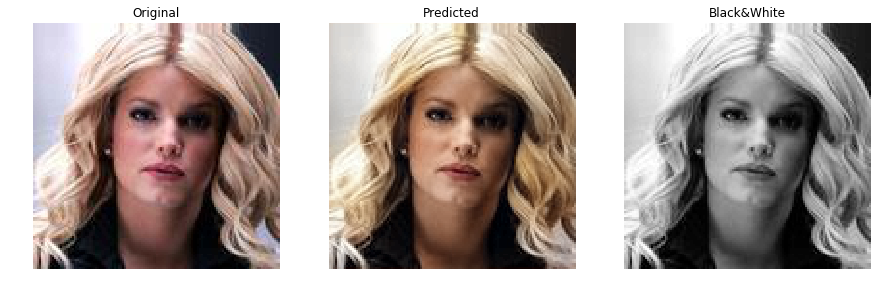

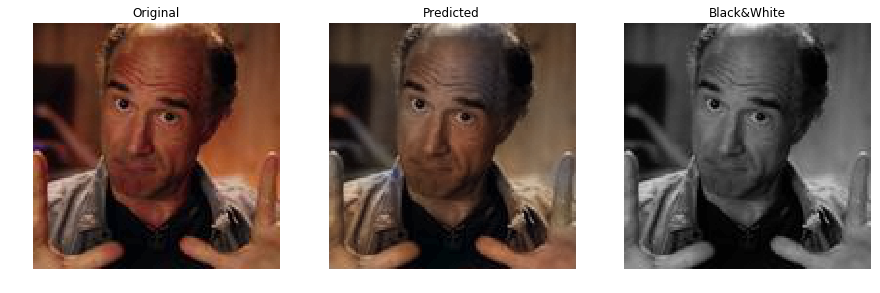

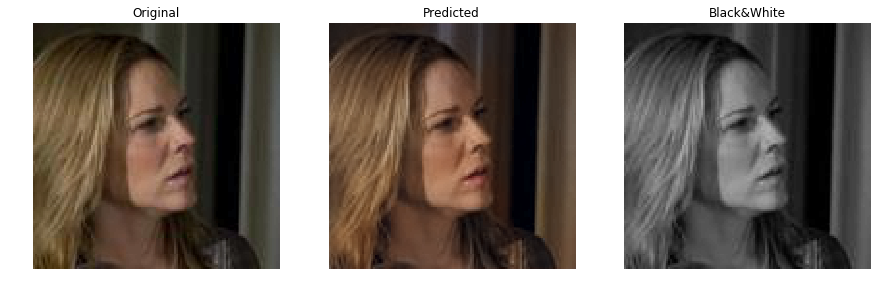

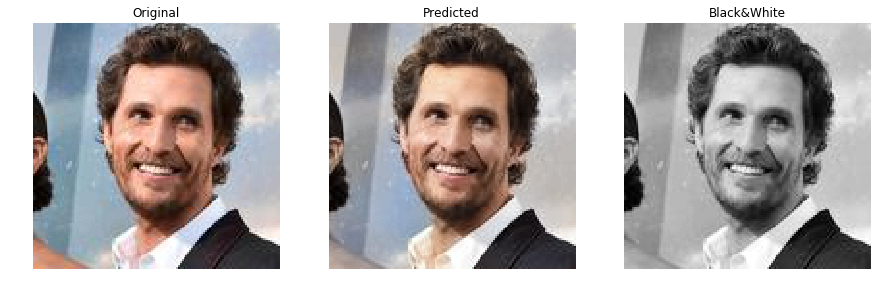

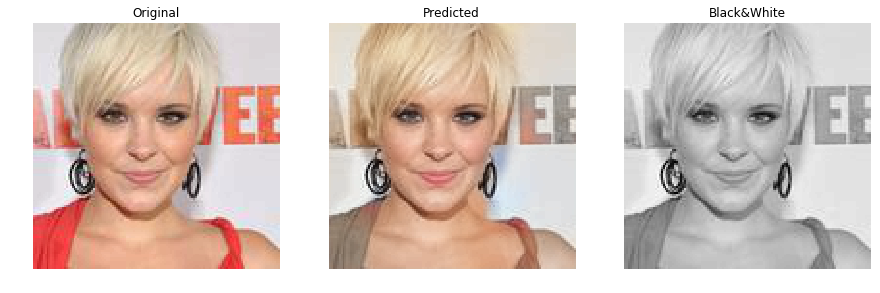

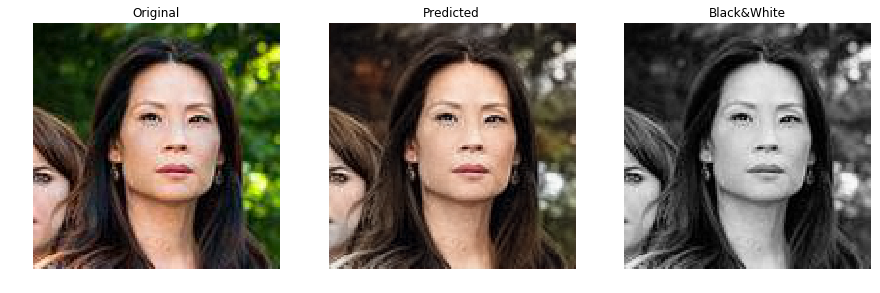

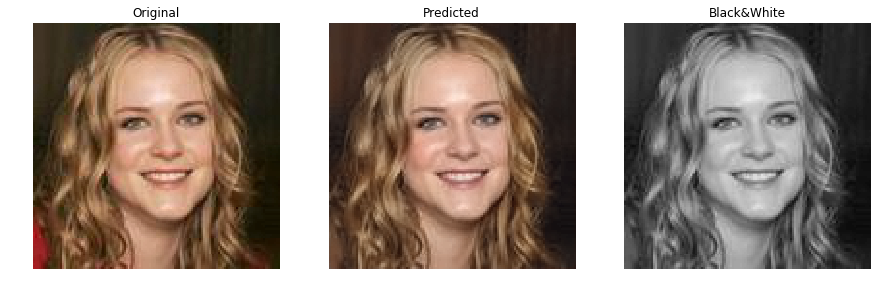

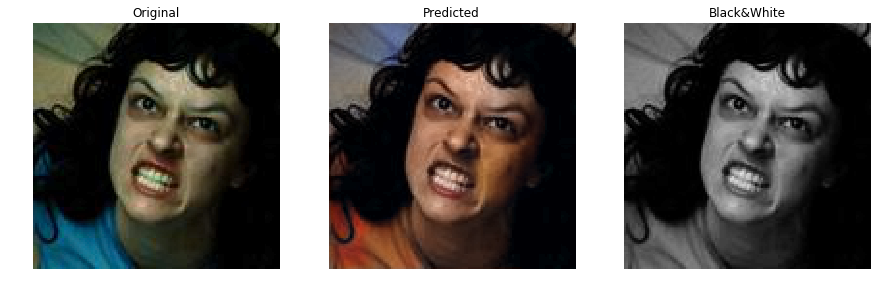

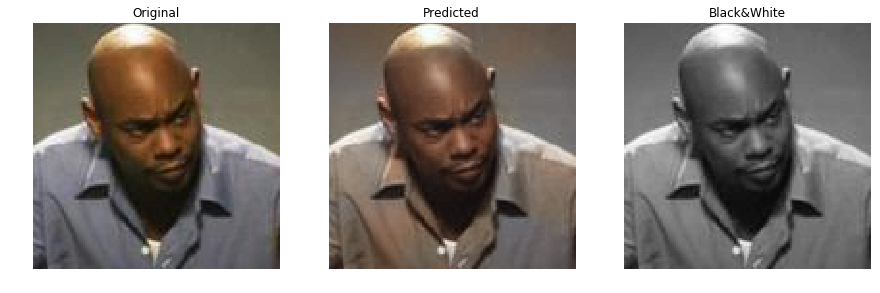

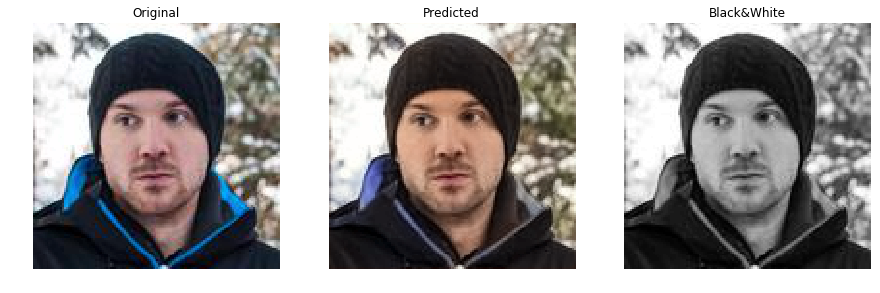

In [7]:
# testing the trained generator
test = h5Lab['test'][0:10].astype(np.float32)
test[:,:,:,0] = test[:,:,:,0]/100 # L channel
test[:,:,:,1:3] = (test[:,:,:,1:3] + 128)/255 # A and B channels
plot_results(generator, test)

In [8]:
discriminator = loadLastModel('disc1') # loading trained discriminator

# create gan with the trained generator and discriminator
gan = GAN_image('gan2', generator = generator,
                discriminator = discriminator)

Loading model: DISC1_01.hdf5
Generator:
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 32) 320         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 128, 128, 32) 128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 128, 128, 32) 0           batch_normalization_1[0][0]      
_____________________________________________________________________

C:\ProgramData\Anaconda3\lib\site-packages\keras\engine\training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


### b, Loading previous GAN model
This option will use the last GAN model to teach the network forward.

In [9]:
combined = loadLastModel('gan2') # load previous gan model

gan = GAN_image('gan2', generator = combined.layers[1],
                discriminator = combined.layers[2])

Loading model: GAN2_36.hdf5


C:\ProgramData\Anaconda3\lib\site-packages\keras\engine\saving.py:327: UserWarning: Error in loading the saved optimizer state. As a result, your model is starting with a freshly initialized optimizer.
  warnings.warn('Error in loading the saved optimizer '


Generator:
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 128, 128, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 32) 320         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 128, 128, 32) 128         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation_1 (Activation)       (None, 128, 128, 32) 0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________

C:\ProgramData\Anaconda3\lib\site-packages\keras\engine\training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


# Teaching the network
After loading the trained UNET (UNET4_72.hdf5) and discriminator (DISC1_01.hdf5) networks we made 36 epochs.

In [9]:
train_gen = generatorGan(h5Lab['train'], batch_size = 64) # train generator

# training GAN
gan.train_generator(train_gen, batch_size = 64, epochs = 9, steps_per_epoch = h5Lab['train'].shape[0]//64,
                   test = h5Lab['test'][82:102])

D loss: 0.18444365 D accuracy: 92.1875 G loss: 2.3551059
Model saved: weights/GAN2/ GAN2_36.hdf5


# Test the network
As the following test pictures show this method can use stronger colors then the simple UNET, but the results are far from final. There are some random color spots in some cases, etc.

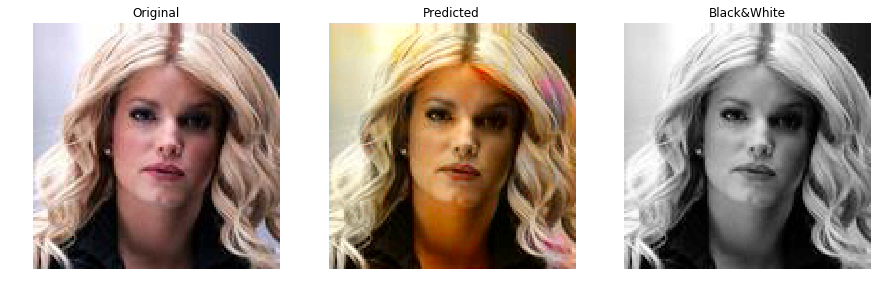

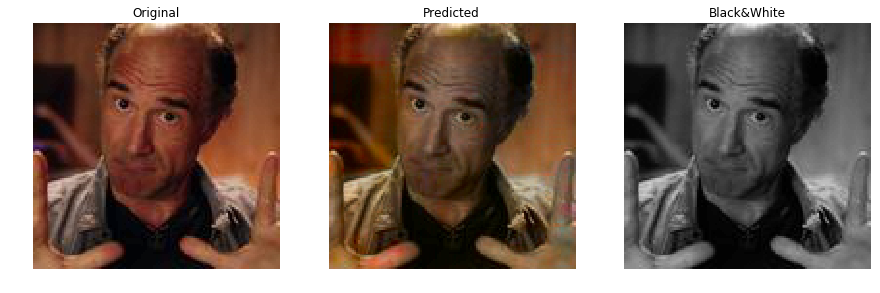

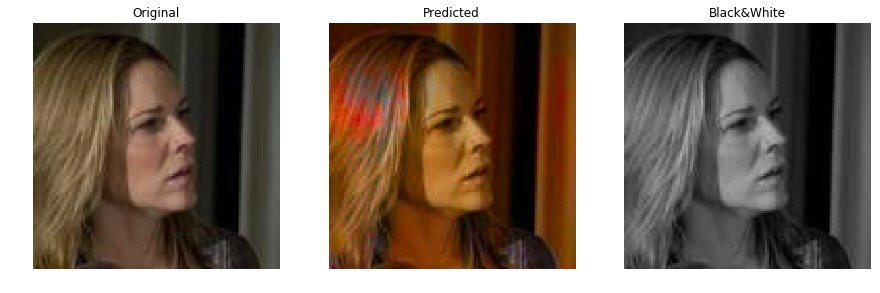

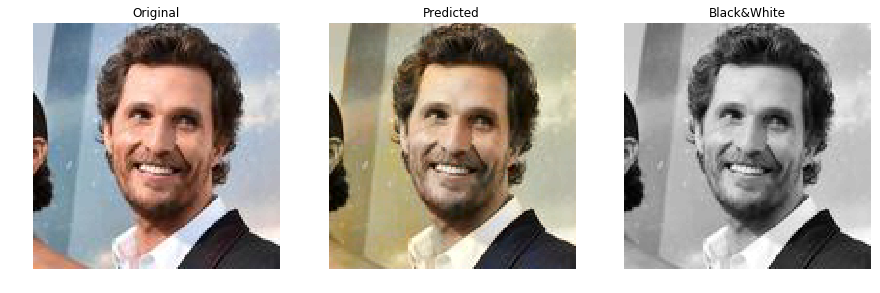

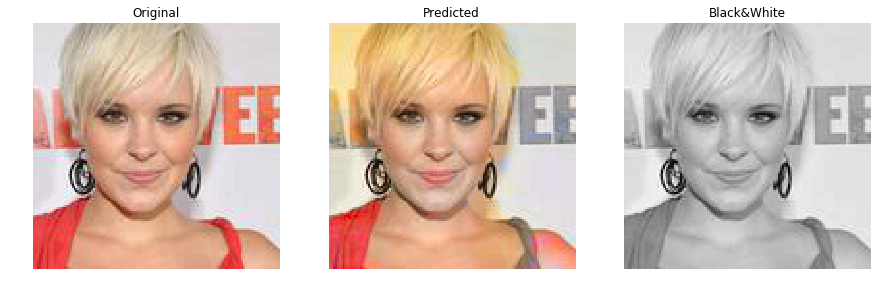

...

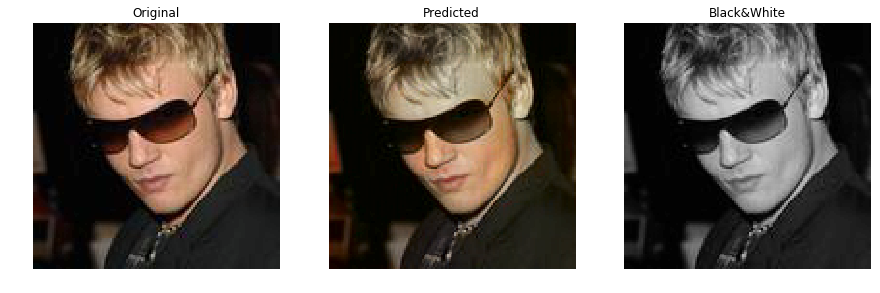

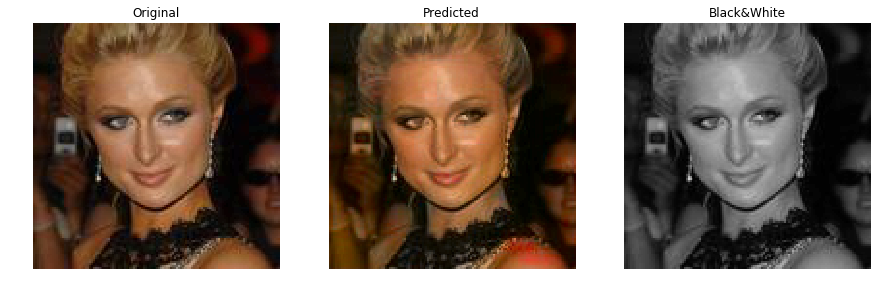

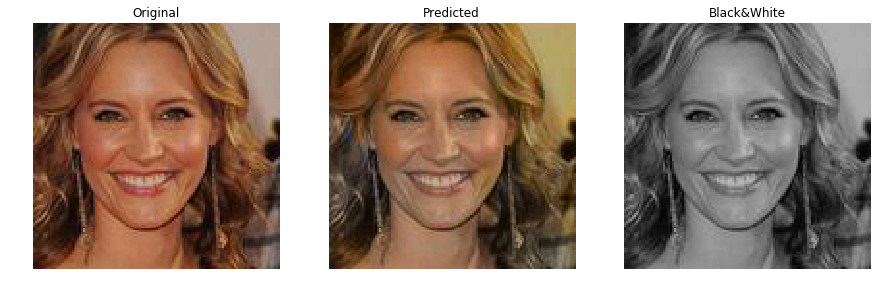

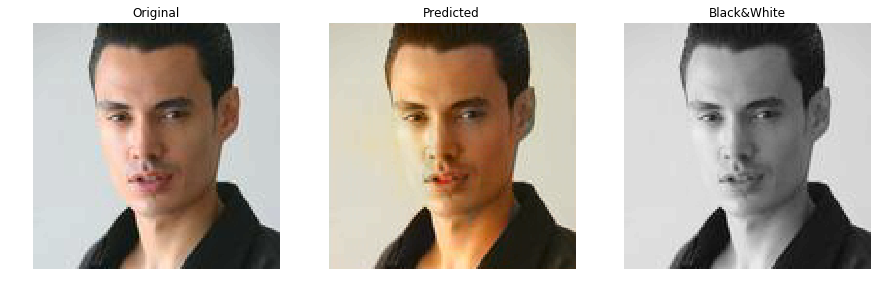

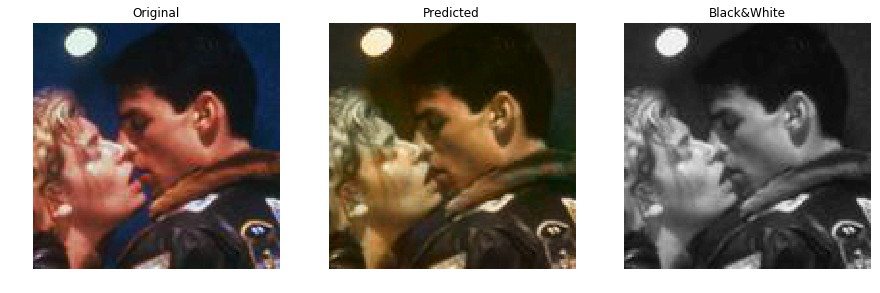

In [10]:
# test gan's results
test = h5Lab['test'][0:200].astype(np.float32)
test[:,:,:,0] = test[:,:,:,0]/100 # L channel
test[:,:,:,1:3] = (test[:,:,:,1:3] + 128)/255 # A and B channels
plot_results(gan.generator, test)